WIP, currently only flow model

In [1]:
#ADDITIONAL DEPENDENCIES
# #!pip install triangle
# #!pip install rasterio
# #!pip install geopy
# #!pip install osmnx

In [2]:
import sys
import os
sys.path.append(r'C:\repos\snkit\src')
sys.path.append(r'C:\repos\ra2ce')
sys.path.append(r'C:\repos\ra2ce_multi_network')
from ci_adapt_utilities import *
from ci_adapt_classes import *
from ra2ce_multi_network.simplify_rail import *
from ra2ce_multi_network.simplify_rail import _merge_edges, _network_to_nx
import networkx as nx
import pandas as pd
from shapely import wkt, box, is_valid, make_valid
import re
from math import ceil

In [3]:
# Load configuration with ini file (created running config.py)
config_file=r'C:\repos\ci_adapt\config_ci_adapt.ini'
config = configparser.ConfigParser()
config.read(config_file)

# Set paths and data sources
p = Path('..')
hazard_type = config.get('DEFAULT', 'hazard_type')
infra_type = config.get('DEFAULT', 'infra_type')
country_code = config.get('DEFAULT', 'country_code')
country_name = config.get('DEFAULT', 'country_name')
hazard_data_subfolders = config.get('DEFAULT', 'hazard_data_subfolders')
asset_data = config.get('DEFAULT', 'asset_data')
vulnerability_data = config.get('DEFAULT', 'vulnerability_data')
data_path = Path(pathlib.Path.home().parts[0]) / 'Data'
interim_data_path = data_path / 'interim' / 'event_data_inspection'/ 'overlapping_floods_shapefiles'

In [23]:
#FUNCTION DEFINITIONS
# Create a bounding box around the graph
def get_bbox(graph):
    min_x = min([attr['pos'][0] for _, attr in graph.nodes(data=True)])
    max_x = max([attr['pos'][0] for _, attr in graph.nodes(data=True)])
    min_y = min([attr['pos'][1] for _, attr in graph.nodes(data=True)])
    max_y = max([attr['pos'][1] for _, attr in graph.nodes(data=True)])
    
    return min_x, max_x, min_y, max_y

# Assign a weight to each edge based on the length of the edge
def set_edge_weights(assets, graph):
    # Create a dictionary to store the length of each asset
    asset_lengths = {str(asset['osm_id']): asset['geometry'].length for asset_id, asset in assets.iterrows()}

    # Loop through the edges and assign the length of the asset to the edge
    for u, v, attr in graph.edges(data=True):
        if 'source_sink' in str(u) or 'source_sink' in str(v):
            continue

        # Initialize the weight and length of the edge
        attr['weight'] = int(0)
        attr['length'] = 0
        if 'osm_id' not in attr:
            continue
        
        # For concatenated edges, split the osm_id string and sum the lengths for each asset
        osm_ids = attr['osm_id'].split('; ')
        for osm_id in osm_ids:
            if osm_id in asset_lengths:
                attr['length'] += asset_lengths[osm_id]
                attr['weight'] += int(round(asset_lengths[osm_id]*1e3,0))

    return graph

def set_edge_capacities(route_data, graph):
    # Make a copy of the graph with only the nodes identified as possible terminals
    terminal_graph = graph.copy()
    for u, attr in graph.nodes(data=True):
        if 'possible_terminal' not in graph.nodes[u]:
            continue
        if attr['possible_terminal'] == 0: 
            terminal_graph.remove_node(u)

    # Create a dictionary to store the shortest path between each OD pair
    paths={}

    # Iterate over all route ODs pairs and find the shortest path between the two nodes
    for _, attr in route_data.iterrows():
        geometry_from = wkt.loads(attr['geometry_from'])
        geometry_to = wkt.loads(attr['geometry_to'])
        
        # Snap route origin and destination geometries to nearest terminal node on graph
        if geometry_from.geom_type == 'Point':
            centroid_from = geometry_from
        else:
            centroid_from = geometry_from.centroid

        from_nearest_node = nearest_nodes(terminal_graph, centroid_from, 1)
        if geometry_to.geom_type == 'Point':
            centroid_to = geometry_to
        else:
            centroid_to = geometry_to.centroid
        to_nearest_node = nearest_nodes(terminal_graph, centroid_to, 1)

        if from_nearest_node[0][0] == to_nearest_node[0][0]:
            continue

        # Find the shortest path between the two terminals
        shortest_path = nx.shortest_path(graph, from_nearest_node[0][0], to_nearest_node[0][0], weight='weight')
        paths[(from_nearest_node[0][0], to_nearest_node[0][0])] = (shortest_path, attr['goods'])               

    # Assign the capacity of the shortest path to the edges in the graph
    for (_,_), (nodes_in_path,cap) in paths.items():
        for i in range(len(nodes_in_path)-1):
            if not graph.has_edge(nodes_in_path[i], nodes_in_path[i+1], 0):
                continue
            if nodes_in_path[i]=='source_sink' or nodes_in_path[i+1]=='source_sink':
                continue 
            if 'capacity' in graph[nodes_in_path[i]][nodes_in_path[i+1]][0]:
                graph[nodes_in_path[i]][nodes_in_path[i+1]][0]['capacity'] = max(graph[nodes_in_path[i]][nodes_in_path[i+1]][0]['capacity'],int(ceil(cap/52)))
            else:
                graph[nodes_in_path[i]][nodes_in_path[i+1]][0]['capacity'] = int(ceil(cap/52))
    
    # Set the capacity of edges that are not on a shortest path to the median capacity
    caps=[]
    for _, _, attr in graph.edges(data=True):
        if 'capacity' in attr:
            caps.append(attr['capacity'])
    
    median_cap = int(np.median(caps))

    for u, v, attr in graph.edges(data=True):
        if 'capacity' not in attr:
            attr['capacity'] = median_cap
        
    return graph

# Function to find the nearest node in a graph to a point
def nearest_nodes(graph, point, n):
    nearest_nodes = []
    for node, attr in graph.nodes(data=True):
        if 'geometry' in attr:
            distance = point.distance(attr['geometry'])
            nearest_nodes.append((node, distance))
    nearest_nodes = sorted(nearest_nodes, key=lambda x: x[1])

    return nearest_nodes[:n]

# Function to set the demand of each node based on the OD data
def set_node_demand(od_data, graph):
    # make a copy of the graph with only the nodes where possible_terminal is 1
    terminal_graph = graph.copy()
    for u, attr in graph.nodes(data=True):
        if attr['possible_terminal'] == 0: 
            terminal_graph.remove_node(u)

    # Loop through od_data and assign demand to the nearest terminal node
    for od in od_data.iterrows():
        if od[1]['geometry'].geom_type == 'Point':
            centroid = od[1]['geometry']
        else:
            centroid = od[1]['geometry'].centroid
        
        nearest_node = nearest_nodes(terminal_graph, centroid, 1)
        graph.nodes[nearest_node[0][0]]['demand'] += int(ceil((od[1]['demand']-od[1]['supply'])/52))
        
    return graph

# Function to make the net demand of the graph equal to zero (condition for minimum cost flow algorithm)
def equalize_demand_supply(graph):
    sumdem=0 
    # Calculate the total demand
    for u,attr in graph.nodes(data=True):
        if attr['demand'] !=0:
            sumdem+=int(attr['demand'])

    # Add a source_sink node with demand equal to negative the total demand, to make the demand and supply equal
    graph.add_node('source_sink', demand=int(-sumdem), pos=graph.nodes[0]['pos'])

    # Add edges from all nodes to the source_sink node
    for u, attr in graph.nodes(data=True):
        if u == 'source_sink':
            continue
        if not graph.has_edge(u, 'source_sink', 0):
            graph.add_edge(u,'source_sink', 0, weight=int(1e10))
        if not graph.has_edge('source_sink', u):
            graph.add_edge('source_sink', u, 0, weight=int(1e10))

    return graph

#Source: SA
def create_virtual_graph(G):
    max_weight_graph = max(attr['weight'] for _, _, attr in G.edges(data=True))
    print('Max weight: '+str(max_weight_graph))
    max_capacity_graph = max(attr['capacity'] for _, _, attr in G.edges(data=True))
    print('Max capacity: '+str(max_capacity_graph))

    # create a virtual node with dummy nodes
    G_v=G.copy()
    # convert to int
    for u, v, key, attr in G.edges(keys=True, data=True):
        G_v.add_edge((str(u) + '_d'), (str(v) + '_d'), **attr)

    for u in G.nodes:
        G_v.add_edge(u,(str(u) + '_d'),capacity=max_capacity_graph*100,weight=int(round(max_weight_graph-1,0)))
        G_v.add_edge((str(u) + '_d'),u,capacity=max_capacity_graph*100,weight=0)

    # verify capacities, weights and demands are integers
    edge_capacities_types, edge_weights_types, node_demands_types = inspect_graph(G_v)
    print("Edge Capacities Types:", set(edge_capacities_types))
    print("Edge Weights Types:", set(edge_weights_types))
    print("Node Demands Types:", set(node_demands_types))
    if {type(int())} == set(list(edge_capacities_types) + list(edge_weights_types) + list(node_demands_types)):
        print('Success: only int type values')
    else: 
        print('Warning! Not all values are integers')

    return G_v

# Function to intersect the assets with hazard polygons
def process_hazard_indirect(single_footprint, assets, geom_dict):
    hazard_name = single_footprint.parts[-1].split('.')[0]
    # load hazard map
    hazard_map = ds.read_flood_map(single_footprint)


    # convert hazard data to epsg 3857
    if '.shp' or '.geojson' in str(hazard_map):
        hazard_map=gpd.read_file(hazard_map).to_crs(3857)[['geometry']] #take only necessary columns (geometry)
    else:
        hazard_map = gpd.GeoDataFrame(hazard_map).set_crs(4326).to_crs(3857)

    # make geometries valid
    hazard_map['geometry'] = hazard_map['geometry'].apply(lambda x: make_valid(x) if not is_valid(x) else x)

    timestamp = datetime.datetime.now().strftime("%Y-%m-%d %H:%M:%S")
    print(f'{timestamp} - Coarse overlay of hazard map with assets...')

    # coarse overlay of hazard map with assets (filter out assets that do not overlay with hazard map)
    intersected_assets=ds.overlay_hazard_assets(hazard_map,assets)
    overlay_assets = pd.DataFrame(intersected_assets.T,columns=['asset','hazard_point'])

    # numpify hazard map
    hazard_numpified = hazard_map.to_numpy() #.drop('w_depth_u', axis=1).to_numpy()
    disrupted_asset_length = {}
    # loop through assets in the same area as hazard map and get damage per asset
    for asset in tqdm(overlay_assets.groupby('asset'),total=len(overlay_assets.asset.unique())): #group asset items for different hazard points per asset and get total number of unique assets
        # retrieve asset geometry and do fine overlay
        asset_geom = geom_dict[asset[0]]              

        # find the exact hazard overlays:
        get_hazard_points = hazard_numpified[asset[1]['hazard_point'].values] 
        get_hazard_points[shapely.intersects(get_hazard_points[0][0],asset_geom)]

        # estimate damage
        if len(get_hazard_points) == 0: # no overlay of asset with hazard
            print('length of get_hazard_points is 0')       

        else:
            if asset_geom.geom_type == 'LineString':
                overlay_meters = shapely.length(shapely.intersection(get_hazard_points[0][0],asset_geom)) # get the length of exposed meters per hazard cell
                disrupted_asset_length[asset[0]]=np.sum(overlay_meters) # sum the total length of exposed meters

    return disrupted_asset_length


# Function to calculate the economic impact of flow disruptions
def calculate_economic_impact(delta_flow, average_train_load_tons, average_train_cost_per_ton_km, average_road_cost_per_ton_km):
    # Initialize the economic impact variable
    economic_impact = 0
    virtual_reduction = []
    # Loop through the edges where there is a change in flow
    for (u,v), d_flow in delta_flow.items():
        if 'source_sink' in str(u) or 'source_sink' in str(v):
            continue
        if str(u).split('_')[0] == str(v).split('_')[0]:
            continue

        # For edges that have an increase in flow, calculate the economic impact of the disruption
        if d_flow > 0:
            # If the edge is between two dummy nodes, the cost of alternate transport mode is considered (road)
            if str(u).split('_')[-1] == 'd' and str(v).split('_')[-1] == 'd':
                economic_impact += d_flow*average_train_load_tons*(average_road_cost_per_ton_km - average_train_cost_per_ton_km)*(G_v.edges[u,v,0]['length']/1000)
            
            # If the edge is between to nodes in the main network, the cost of the train is considered
            elif type(u)==int and type(v)==int:
                economic_impact += d_flow*average_train_load_tons*average_train_cost_per_ton_km*(G_v.edges[u,v,0]['length']/1000)
            else:
                print(f'Error in {u,v}')
        
        # For edges that have a decrease in flow, the cost is subtracted (since d_flow is negative)
        #TODO What should happen when flow through dummy nodes decreases?
        if d_flow < 0:
            if type(u)==int and type(v)==int:
                economic_impact += d_flow*average_train_load_tons*average_train_cost_per_ton_km*(G_v.edges[u,v,0]['length']/1000)
            elif str(u).split('_')[-1] == 'd' and str(v).split('_')[-1] == 'd':
                virtual_reduction.append((u,v))
             
            else:
                print(f'Error in {u,v}')
            
    if len(virtual_reduction)>0:
        print(f'Flow decrease between dummy nodes: {virtual_reduction}. \nNo cost is considered.')

    return economic_impact


#TODO: remove if not used
def inspect_graph(graph):
    edge_capacities_types = []
    edge_weights_types = []
    node_demands_types = []

    for _, _, attr in graph.edges(data=True):
        if 'capacity' in attr:
            edge_capacities_types.append(type(attr['capacity']))
        if 'weight' in attr:
            edge_weights_types.append(type(attr['weight']))

    for _, attr in graph.nodes(data=True):
        if 'demand' in attr:
            node_demands_types.append(type(attr['demand']))

    return edge_capacities_types, edge_weights_types, node_demands_types

def delta_flow_analysis(delta_flow,event_name):
    source_sink_increase=[] # These are the flows that increase to or from the source_sink node. Highest cost nodes so only activated if the node is disconnected
    source_sink_decrease=[] # These are the flows that decrease to or from the source_sink node. 
    real_edges_increase=[] # Increase in flow on previously unsaturated edge 
    real_edges_decrease=[] # Decrease in flow 
    dummy_edges_increase=[] # Increase in flow on dummy edges if exceeding capacity
    dummy_edges_decrease=[] # Decrease in flow on dummy edges
    overflow_edges_increase=[] # Increase in flow on mixed edges 
    overflow_edges_decrease=[] # Decrease in flow on mixed edges
    for (event_name, (u,v)), d_flow in delta_flow.items():
        if 'source_sink' in str(u) or 'source_sink' in str(v):
            if d_flow > 0:
                source_sink_increase.append(((u,v),d_flow))
            if d_flow < 0:
                source_sink_decrease.append(((u,v),d_flow))
            continue
        if type(u)==int and type(v)==int:
            if d_flow > 0:
                real_edges_increase.append(((u,v),d_flow))
            if d_flow < 0:  
                real_edges_decrease.append(((u,v),d_flow))
            continue
        if str(u).split('_')[-1] == 'd' and str(v).split('_')[-1] == 'd':
            if d_flow > 0:
                dummy_edges_increase.append(((u,v),d_flow))
            if d_flow < 0:  
                dummy_edges_decrease.append(((u,v),d_flow))
            continue
        if str(u).split('_')[-1] == 'd' or str(v).split('_')[-1] == 'd':
            if d_flow > 0:
                overflow_edges_increase.append(((u,v),d_flow))
            if d_flow < 0:  
                overflow_edges_decrease.append(((u,v),d_flow))
            continue
        else:
            print(f'Error in {u,v}',end=' ')
    print(f'\n\nIncrease in flow to source_sink: {len(source_sink_increase)}')
    print(f'Decrease in flow to source_sink: {len(source_sink_decrease)}')
    print(f'Increase in flow on real edges: {len(real_edges_increase)}')
    print(f'Decrease in flow on real edges: {len(real_edges_decrease)}')
    print(f'Increase in flow on dummy edges: {len(dummy_edges_increase)}')
    print(f'Decrease in flow on dummy edges: {len(dummy_edges_decrease)}')
    print(f'Increase in flow on overflow edges: {len(overflow_edges_increase)}')
    print(f'Decrease in flow on overflow edges: {len(overflow_edges_decrease)}\n\n')
    return source_sink_increase, source_sink_decrease, real_edges_increase, real_edges_decrease, dummy_edges_increase, dummy_edges_decrease, overflow_edges_increase, overflow_edges_decrease
   



In [5]:
# Read exposure data (OSM, OpenStreetMap contributors (2024) / osm-flex)
assets_path = data_path / asset_data
assets = gpd.read_file(assets_path)
assets = gpd.GeoDataFrame(assets).set_crs(4326).to_crs(3857)
assets = assets.loc[assets.geometry.geom_type == 'LineString']
assets = assets.rename(columns={'railway' : 'asset'})

# Add buffer to assets to do area intersect and create dictionaries for quicker lookup
buffered_assets = ds.buffer_assets(assets)
geom_dict = assets['geometry'].to_dict()
type_dict = assets['asset'].to_dict()

print(f"{len(assets)} assets loaded.")

126925 assets loaded.


In [6]:
from shapely.geometry import LineString
# Round coordinates to 0 decimal places to avoid GEOSException: TopologyException: side location conflict at x, y
def round_coordinates(line):
    rounded_coords = []
    for coord in line.coords:
        rounded_coords.append((round(coord[0], 0), round(coord[1], 0)))
    return LineString(rounded_coords)

geoms=[]
for geom in assets['geometry']:
    geoms.append(round_coordinates(geom))

assets['geometry']=geoms

In [7]:
import warnings

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    #Source: Asgarpour/snkit
    # Create a railway networks with possible terminal nodes. This returns a complex network, as includes the rail tracks with the highest level of detail.
    aggregation_range = 0.08 # in km
    complex_rail_network = get_rail_network_with_terminals(network_gdf=assets, aggregation_range=aggregation_range)


In [9]:
with warnings.catch_warnings():
    try:
        warnings.simplefilter("ignore")
        merged_rail_network = _merge_edges(network=complex_rail_network, excluded_edge_types=['bridge', 'tunnel']) #Must add network= to pass excluded_edge_types as a keyword argument

        # Number of nodes and edges reduced
        print(f"Difference in node counts: {complex_rail_network.nodes.shape[0] - merged_rail_network.nodes.shape[0]}")
        print(f"Difference in node counts %: {round(100*(complex_rail_network.nodes.shape[0] - merged_rail_network.nodes.shape[0])/complex_rail_network.nodes.shape[0], 0)}")
        print(f"Difference in edge counts: {complex_rail_network.edges.shape[0] - merged_rail_network.edges.shape[0]}")
        print(f"Difference in edge counts %: {round(100*(complex_rail_network.edges.shape[0] - merged_rail_network.edges.shape[0])/complex_rail_network.edges.shape[0], 0)}")
    except Exception as e:
        print(f'Exception: {e}')
        print('Skipping simplification step.')
        merged_rail_network=complex_rail_network
    
    merged_rail_graph = _network_to_nx(merged_rail_network)


Exception: 'pop from an empty set'
Skipping simplification step.


In [10]:
G=nx.MultiDiGraph(merged_rail_graph)

# Initialise demand and give position to nodes
for _, attr in G.nodes(data=True):
    attr['demand'] = int(0)
    attr['pos'] = (attr['geometry'].x, attr['geometry'].y)

bbox_shape=box(*get_bbox(G))

In [11]:
# Set weights for flow model
G = set_edge_weights(assets, G)


In [12]:
# Load OD data
#TODO rename od_dat_2.csv to supply demand for clarity after addidng od method for capacity setting
od_data_source = r'C:\Data\interim\od_data_2.csv'
od_data = pd.read_csv(od_data_source)

# Drop rows where 'geometry' is NaN
od_data = od_data.dropna(subset=['geometry'])

# Convert 'geometry' column to shapely geometry
od_data['geometry'] = od_data['geometry'].apply(wkt.loads)

# Filter OD data to only include points within the bounding box of the graph
od_data = od_data[od_data['geometry'].apply(lambda geom: bbox_shape.contains(geom))]

In [13]:
# Set demand for flow model
G = set_node_demand(od_data, G)
G = equalize_demand_supply(G)


In [14]:
# Load route data
route_data_source='C:/Data/interim/route_traffic_DEU_net_seg20.csv'
route_data = pd.read_csv(route_data_source)

# Drop rows where 'geometry_from' and 'geometry_to' are NaN
route_data = route_data.loc[route_data['geometry_from'].notnull()]
route_data = route_data.loc[route_data['geometry_to'].notnull()]

# Convert 'geometry_from' and 'geometry_to' columns to shapely geometry
route_data = route_data.loc[route_data['geometry_from'] != route_data['geometry_to']]

# Filter route data to only include routes that start and end the bounding box of the graph
route_data = route_data[route_data['geometry_from'].apply(lambda geom: bbox_shape.contains(wkt.loads(geom)))]
route_data = route_data[route_data['geometry_to'].apply(lambda geom: bbox_shape.contains(wkt.loads(geom)))]


In [15]:
# Set capacities for flow model
G = set_edge_capacities(route_data, G)


In [16]:
# Create initial virtual graph
G_v0=create_virtual_graph(G)


Max weight: 10000000000
Max capacity: 872
Edge Capacities Types: {<class 'int'>}
Edge Weights Types: {<class 'int'>}
Node Demands Types: {<class 'int'>}
Success: only int type values


In [17]:
# Solve the min cost flow problem and get the flow dictionary
flow_dict=nx.min_cost_flow(G_v0)
print('Minimum cost flow: '+str(flow_dict))


Minimum cost flow: {0: {117543: {0: 0}, 9124: {0: 0}, 'source_sink': {0: 0}, '0_d': {0: 0}}, 1: {117543: {0: 0}, 137724: {0: 0}, 'source_sink': {0: 0}, '1_d': {0: 0}}, 2: {16997: {0: 0}, 'source_sink': {0: 0}, '2_d': {0: 0}}, 3: {16995: {0: 0}, 16996: {0: 0}, 13709: {0: 0}, 'source_sink': {0: 0}, '3_d': {0: 0}}, 4: {5: {0: 0}, 83317: {0: 67}, 'source_sink': {0: 0}, '4_d': {0: 0}}, 5: {4: {0: 67}, 10908: {0: 0}, 'source_sink': {0: 0}, '5_d': {0: 0}}, 6: {7: {0: 0}, 122693: {0: 0}, 'source_sink': {0: 0}, '6_d': {0: 0}}, 7: {6: {0: 0}, 15225: {0: 0}, 'source_sink': {0: 0}, '7_d': {0: 0}}, 8: {9: {0: 0}, 89999: {0: 67}, 'source_sink': {0: 0}, '8_d': {0: 0}}, 9: {8: {0: 67}, 93746: {0: 0}, 126153: {0: 0}, 'source_sink': {0: 0}, '9_d': {0: 0}}, 10: {98730: {0: 0}, 89994: {0: 0}, 'source_sink': {0: 0}, '10_d': {0: 0}}, 11: {98730: {0: 58}, 90045: {0: 0}, 'source_sink': {0: 0}, '11_d': {0: 0}}, 12: {98729: {0: 0}, 2607: {0: 58}, 'source_sink': {0: 0}, '12_d': {0: 0}}, 13: {98729: {0: 0}, 5664:

In [18]:
event_database_path=r'C:\Users\peregrin\Downloads\Paprotny Flood Events Data\HANZE_potential_flood_catalogue_all.csv'

# Read the event database file
event_df = pd.read_csv(event_database_path)
event_df.head(3)
events = [event for event in os.listdir(interim_data_path) if event.endswith(".shp")]

# Define costs for different transport modes
average_train_load_tons = (896+1344+2160+1344+896+896+1344+1512+896+390)/10 # in Tons per train. Source: Kennisinstituut voor Mobiliteitsbeleid. 2023. Cost Figures for Freight Transport – final report
average_train_cost_per_ton_km = (0.014+0.018+0.047+0.045)/4 # in Euros per ton per km. Source: Kennisinstituut voor Mobiliteitsbeleid. 2023. Cost Figures for Freight Transport – final report
average_road_cost_per_ton_km = (0.395+0.375+0.246+0.203+0.138+0.153+0.125+0.103+0.122+0.099)/10 # in Euros per ton per km. Source: Kennisinstituut voor Mobiliteitsbeleid. 2023. Cost Figures for Freight Transport – final report

In [83]:
# Loop through the event files and calculate the economic impact of each event
disrupted_asset_lengths={}
event_impacts={}
delta_flow={}

for event in events:
    event_name = event.split('.')[0]
    event_path = interim_data_path / event
    disrupted_asset_lengths[event_name]=process_hazard_indirect(event_path, assets, geom_dict)
    disrupted_osm_ids=[assets.loc[asset_index]['osm_id'] for asset_index in disrupted_asset_lengths[event_name].keys()]
    disrupted_edges=[]
    for u,v,attr in G.edges(data=True):
        if 'osm_id' not in attr: 
            continue
        if attr['bridge']=='yes' or attr['tunnel']=='yes':
            continue
        matching_ids=[osm_id for osm_id in attr['osm_id'].split('; ') if osm_id in disrupted_osm_ids]
        if len(matching_ids)>0:
            disrupted_edges.append((u,v))

    print(f'Disrupted edges: {len(disrupted_edges)}')
    
    # Create a virtual graph with the disrupted edges
    print('Resetting virtual graph...')
    G_v=G_v0.copy()

    for u,v in disrupted_edges:
        G_v.edges[u,v,0]['capacity']=0
    print('Solving min cost flow problem...')
    # Solve the min cost flow problem
    mcf=nx.min_cost_flow(G_v)
    
    # Record the change in flow for each edge
    print('Recording change in flow...')
    for u, vs in mcf.items():
        for v, flow in vs.items():
            d_flow = flow[0]-flow_dict[u][v][0]
            if d_flow != 0:
                delta_flow[event_name,(u,v)] = d_flow
    print(f'Flow changes:')
    source_sink_increase, source_sink_decrease, real_edges_increase, real_edges_decrease, dummy_edges_increase, dummy_edges_decrease, overflow_edges_increase, overflow_edges_decrease = delta_flow_analysis(delta_flow, event_name)
 

    print('Calculating economic impact...')
    change_in_flow={(u,v):value for (event, (u,v)), value in delta_flow.items() if event == event_name}
    impact=calculate_economic_impact(change_in_flow, average_train_load_tons, average_train_cost_per_ton_km, average_road_cost_per_ton_km)
    print(f'Weekly economic impact of {event_name}: {impact:,.2f} EUR') #These are counterfactual forcings with current infrastructure, so no need to discount future costs
    event_impacts[event_name, event_df[event_df['ID']==int(event_name.split('_')[1])]['Return period'].values[0]]=impact



Flood map path: C:\Data\interim\event_data_inspection\overlapping_floods_shapefiles\Event_28000_DE_1950_River.shp
2024-05-26 23:27:44 - Coarse overlay of hazard map with assets...
Disrupted edges: 16
Resetting virtual graph...
Solving min cost flow problem...
Recording change in flow...
Flow changes:


Increase in flow to source_sink: 2
Decrease in flow to source_sink: 2
Increase in flow on real edges: 14
Decrease in flow on real edges: 0
Increase in flow on dummy edges: 0
Decrease in flow on dummy edges: 14
Increase in flow on overflow edges: 3
Decrease in flow on overflow edges: 3


Calculating economic impact...
Flow decrease between dummy nodes: [('19538_d', '14826_d'), ('14828_d', '19533_d'), ('14826_d', '55840_d'), ('55840_d', '55854_d'), ('19533_d', '19534_d'), ('118635_d', '14828_d'), ('19534_d', '19535_d'), ('19535_d', '118634_d'), ('118634_d', '19536_d'), ('19536_d', '19537_d'), ('19537_d', '19538_d'), ('55833_d', '55827_d'), ('55839_d', '55833_d'), ('55854_d', '55839_d')]. 


Error in setting node source_sink position


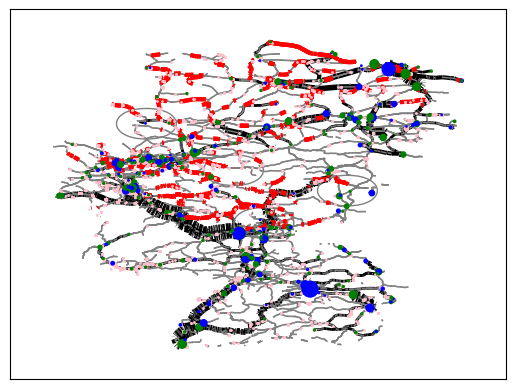

In [28]:
# Visualisation
extract_numeric_part = lambda s: int(re.search(r'\d+', s).group()) if re.search(r'\d+', s) else None

for u,attr in G_v.nodes(data=True):
    try:
        if isinstance(u, int): 
            pass
        elif isinstance(u, str): 
            if u == 'source_sink_d':
                attr['pos']=(G.nodes['source_sink']['pos'][0],G_v.nodes['source_sink']['pos'][-1])
            else:
                attr['pos']=(G_v.nodes[extract_numeric_part(u)]['pos'][0]+0.0005,G_v.nodes[extract_numeric_part(u)]['pos'][-1]+0.0005)
    except:
        print(f'Error in setting node {u} position')    
pos=nx.get_node_attributes(G, 'pos')
nodelist=[u for u, attr in G.nodes(data=True) if 'demand' in attr and attr['demand'] != 0]
edgelist=[(u, v) for u, v, attr in G.edges(data=True) if (type(u) == int and type(v) == int)]
node_size=[int(abs(ceil(attr['demand']/5))+1) for u, attr in G.nodes(data=True) if 'demand' in attr and attr['demand'] != 0]
width=[int(ceil(mcf[u][v][0]/20)+1) for u, v in edgelist]
node_labels={u:G.nodes[u]['demand'] for u in nodelist}

# draw network
# Draw the graph 
nx.draw_networkx(G, pos,
        nodelist=nodelist,
        edgelist=edgelist,
        with_labels=False,
        arrows=False,
        node_size=0,
        node_color=['green' if attr['demand'] > 0 else 'blue' for u, attr in G.nodes(data=True) if 'demand' in attr and attr['demand'] != 0],
        width=width,
        edge_color=['grey' if width[i] == 1 else 'black' for i in range(len(width))])

# Draw the possible terminal nodes
nx.draw_networkx_nodes(G, pos, nodelist=[u for u, attr in G.nodes(data=True) if 'possible_terminal' in attr and attr['possible_terminal'] == 1], node_color='pink', node_size=1)

# Add the supply and demand coloring
nx.draw_networkx_nodes(G, pos, 
                       nodelist=nodelist, 
                       node_color=['green' if attr['demand'] > 0 else 'blue' for u, attr in G.nodes(data=True) if 'demand' in attr and attr['demand'] != 0], 
                       node_size=node_size)

# Draw the disrupted edges
nx.draw_networkx_edges(G, pos, edgelist=disrupted_edges, edge_color='red',style='--', width=3, arrows=False)



Monitoring code

In [21]:
#disrupted_asset_lengths
#event_impacts
delta_flow

{('Event_28000_DE_1950_River', (14826, 55840)): 16,
 ('Event_28000_DE_1950_River', (14828, 19533)): 33,
 ('Event_28000_DE_1950_River', (19533, 19534)): 33,
 ('Event_28000_DE_1950_River', (19534, 19535)): 16,
 ('Event_28000_DE_1950_River', (19535, 118634)): 16,
 ('Event_28000_DE_1950_River', (19536, 19537)): 16,
 ('Event_28000_DE_1950_River', (19537, 19538)): 16,
 ('Event_28000_DE_1950_River', (19538, 14826)): 16,
 ('Event_28000_DE_1950_River', (42468, 'source_sink')): 13,
 ('Event_28000_DE_1950_River', (42468, '42468_d')): -13,
 ('Event_28000_DE_1950_River', (55833, 55827)): 100,
 ('Event_28000_DE_1950_River', (55839, 55833)): 100,
 ('Event_28000_DE_1950_River', (55840, 55854)): 100,
 ('Event_28000_DE_1950_River', (55854, 55839)): 100,
 ('Event_28000_DE_1950_River', (80253, 'source_sink')): -13,
 ('Event_28000_DE_1950_River', (80253, '80253_d')): 13,
 ('Event_28000_DE_1950_River', (118634, 19536)): 16,
 ('Event_28000_DE_1950_River', (118635, 14828)): 33,
 ('Event_28000_DE_1950_River', 

In [29]:
# Initialize a list to store rows
rows = []
for (event_name, rp), event_cost in event_impacts.items():
    change_flows={(u,v):value for (event, (u,v)), value in delta_flow.items() if event == event_name}
    tdl=sum(disrupted_asset_lengths[event_name].values())
    row = {'event_name': event_name, 'rp': rp, 'event_cost': event_cost, 'total_disrupted_length':tdl,'num_disrupted_assets':len(disrupted_asset_lengths[event_name].keys()),'disrupted_assets': disrupted_asset_lengths[event_name], 'change_flows': change_flows}
  
    # Append the row to the list
    rows.append(row)

# Convert the list of rows to a DataFrame
disruptions_df = pd.DataFrame(rows)
dest_path = data_path / 'interim' / 'collected_flood_runs' / 'índirect_damage_test_2.csv'
disruptions_df.to_csv(dest_path, index=False)

In [82]:
od_data

,Unnamed: 0,demand,supply,geometry
7,Lübeck Hbf,10070.0,9914.0,POINT (1187762.825438064 7145119.955862997)
12,Bad Oldesloe,7188.0,7184.0,"POLYGON ((1146141.803664348 7134333.55561848, ..."
13,Ahrensburg-Gartenholz,7169.0,7170.0,POINT (1141244.302666898 7111482.778674921)
14,Ahrensburg SH/HH,7194.0,7200.0,POINT (1132915.044407273 7107100.521654914)
15,Hamburg Hbf,14461.0,10275.0,POINT (1114036.928561096 7085893.326692171)
...,...,...,...,...
1251,Salzwedel ST/NI,9683.0,10194.0,LINESTRING (1244849.686706671 6963219.03401242...
1253,Wieren,9682.0,9684.0,"POLYGON ((1180301.191289682 6965006.637550382,..."
1257,Berlin-Rummelsburg (BZ),2.0,2.0,"POLYGON ((1499314.688072033 6890979.002381026,..."
1259,Oftersheim,2781.0,13.0,"POLYGON ((953123.8253829834 6337538.113709162,..."


In [30]:
disruptions_df.sort_values(by='event_cost', ascending=False)

,event_name,rp,event_cost,total_disrupted_length,num_disrupted_assets,disrupted_assets,change_flows
29,Event_28051_DE_1956_River,2.30,3.355038e+07,2.314589e+06,8557,"{10: 260.4797706550521, 11: 278.14108495917606...","{(4, 83317): -21, (5, 4): -21, (8, 89999): -21..."
40,Event_28074_DE_1958_River,2.12,2.791399e+07,3.525616e+06,12769,"{10: 260.4797706550521, 11: 278.14108495917606...","{(4, 83317): -67, (5, 4): -67, (8, 89999): -67..."
20,Event_28034_DE_1954_River,1.92,2.355226e+07,1.396704e+06,5126,"{10: 260.48053387303787, 18: 411.9578085977387...","{(4, 83317): -46, (5, 4): -46, (8, 89999): -46..."
4,Event_28008_DE_1951_River,3.53,2.230233e+07,5.946205e+05,2204,"{11: 278.14108495917606, 12: 92.58501647698913...","{(4, 83317): 47, (5, 4): 47, (8, 89999): 47, (..."
22,Event_28041_DE_1955_River,2.86,2.151269e+07,2.559661e+06,8310,"{16: 96.18076300081239, 43: 2919.032306889132,...","{(4, 83317): -25, (5, 4): -25, (8, 89999): -25..."
35,Event_28064_DE_1957_River,1.70,1.940157e+07,1.797459e+06,6954,"{10: 260.4797706550521, 11: 278.14108495917606...","{(4, 83317): -67, (5, 4): -67, (8, 89999): -67..."
30,Event_28057_DE_1956_River,3.35,1.727367e+07,2.005935e+06,7144,"{10: 260.48053387303787, 18: 411.9578085977387...","{(4, 83317): -42, (5, 4): -42, (8, 89999): -42..."
45,Event_28081_DE_1959_River,1.52,1.166970e+07,5.961988e+05,1977,"{817: 145.49568812631495, 865: 3481.3873700165...","{(4, 83317): -31, (5, 4): -31, (8, 89999): -31..."
17,Event_28029_DE_1953_River,2.03,1.079519e+07,1.011970e+05,445,"{47: 663.9305968356794, 553: 958.6073065718482...","{(4, 83317): 80, (5, 4): 80, (8, 89999): 80, (..."
41,Event_28076_DE_1958_River,2.25,1.014322e+07,3.100864e+05,1086,"{83: 133.61909311799505, 259: 3168.55127486098...","{(4, 83317): -22, (5, 4): -22, (8, 89999): -22..."


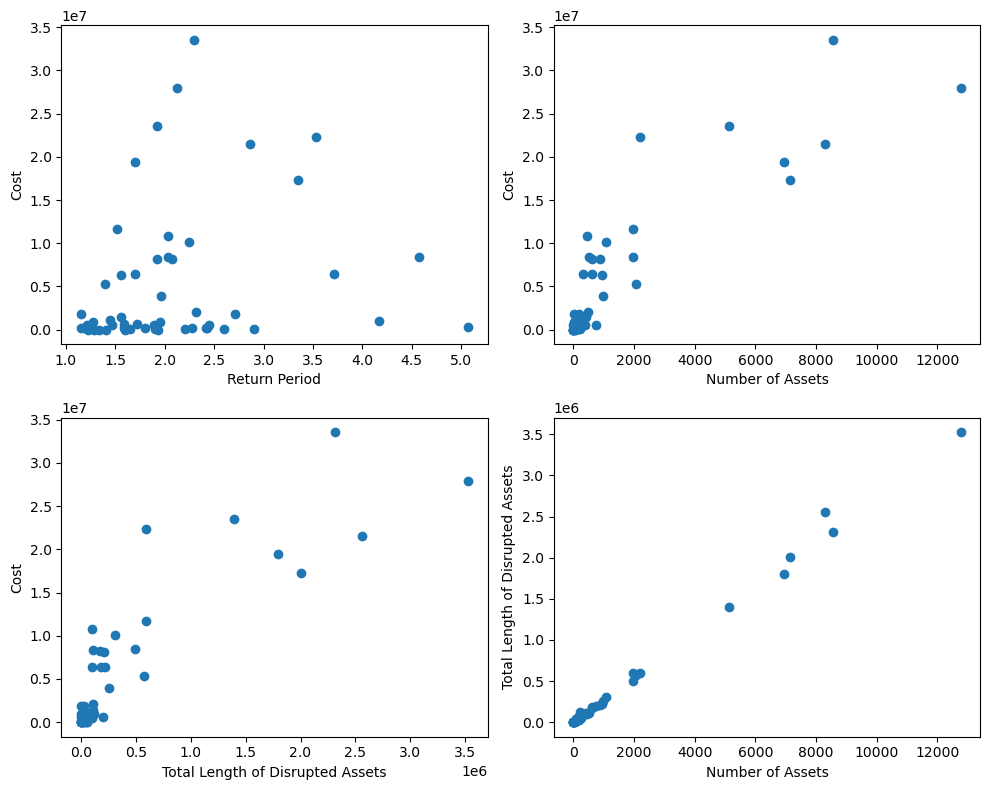

In [31]:
import matplotlib.pyplot as plt

# Create a figure and subplots
fig, axs = plt.subplots(2, 2, figsize=(10, 8))
df=disruptions_df[disruptions_df['event_name']!='Event_28000_DE_1950_River']
# Plot 1: Cost vs Return Period
axs[0, 0].scatter(df['rp'], df['event_cost'])
axs[0, 0].set_xlabel('Return Period')
axs[0, 0].set_ylabel('Cost')

# Plot 2: Cost vs Number of Assets
axs[0, 1].scatter(df['num_disrupted_assets'], df['event_cost'])
axs[0, 1].set_xlabel('Number of Assets')
axs[0, 1].set_ylabel('Cost')

# Plot 3: Cost vs Total Length of Disrupted Assets
axs[1, 0].scatter(df['total_disrupted_length'], df['event_cost'])
axs[1, 0].set_xlabel('Total Length of Disrupted Assets')
axs[1, 0].set_ylabel('Cost')

# Plot 4: Total Length of Disrupted Assets vs Number of Assets
axs[1, 1].scatter(df['num_disrupted_assets'], df['total_disrupted_length'])
axs[1, 1].set_xlabel('Number of Assets')
axs[1, 1].set_ylabel('Total Length of Disrupted Assets')

# Adjust spacing between subplots and show the plot
plt.tight_layout()
plt.show()

In [34]:
assets.loc[4829]['osm_id']

'24243415'

In [33]:
disrupted_asset_lengths['Event_28000_DE_1950_River']

{4829: 607.3359519351529,
 4830: 120.79770266845718,
 4831: 444.50497868022904,
 4832: 52.93054186964955,
 4833: 30.67927320737079,
 22727: 167.71994130104122,
 76116: 106.78956265285613,
 76117: 124.79943269828907,
 76119: 221.05549665519425,
 82417: 16.809409046161015,
 95097: 178.4392635715962,
 121246: 37.134062179279326}

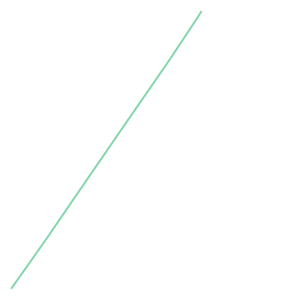

In [36]:
geom_dict[4829]

In [44]:
assets.loc[4829]

osm_id                                                           24243415
asset                                                                rail
name                                          Kinzigtalbahn (Schwarzwald)
gauge                                                                1435
electrified                                                            no
voltage                                                              None
bridge                                                               None
maxspeed                                                               70
service                                                              None
tunnel                                                               None
other_tags              "operator"=>"DB Netz","passenger_lines"=>"1","...
railway:traffic_mode                                          "passenger"
usage                                                            "branch"
geometry                LINESTRING (93

In [60]:
# disrupted_asset_lengths['Event_28000_DE_1950_River'][4829]


dict_keys([1186, 1190, 1586, 1587, 1598, 1599, 1600, 1654, 1657, 1659, 1660, 1703, 1827, 1828, 1914, 2023, 2024, 2070, 2218, 2223, 2362, 2379, 2398, 2518, 2532, 2533, 2534, 2707, 3088, 3524, 3525, 3526, 3543, 3684, 3687, 3692, 3693, 3694, 3695, 3696, 3697, 3698, 3699, 3700, 3727, 3728, 3738, 3827, 3856, 3933, 3934, 3948, 4002, 4329, 4372, 4496, 4498, 4499, 4531, 4636, 4655, 4658, 4660, 4662, 4663, 4880, 5254, 5255, 5258, 5259, 5260, 5261, 5262, 5271, 5302, 5304, 5351, 5467, 5470, 5502, 5553, 5645, 5646, 5676, 5728, 5729, 5764, 5800, 5801, 5802, 5806, 5807, 5823, 5844, 5850, 5889, 5890, 5892, 6046, 6047, 6048, 6049, 6130, 6399, 6402, 6414, 6415, 6490, 6614, 6938, 6939, 7022, 7070, 7071, 7076, 7077, 7078, 7106, 7365, 7366, 7367, 7368, 7447, 7535, 7663, 7684, 7686, 7687, 7749, 7750, 7825, 7826, 7829, 7830, 8049, 8050, 8058, 8068, 8162, 8163, 8185, 8248, 8249, 8251, 8621, 8622, 9084, 9120, 9121, 9185, 9186, 9208, 9209, 9210, 9249, 9251, 9252, 9254, 9341, 9442, 9443, 9447, 9629, 9739, 9855,

In [ ]:
import geopandas as gpd
import lonboard as lb

name1='Event_28051_DE_1956_River'
name2='Event_28074_DE_1958_River'

# Load the GeoDataFrames
gdf1 = gpd.read_file(interim_data_path / (name1 + '.shp'))
gdf2 = gpd.read_file(interim_data_path / (name2 + '.shp'))

# lb.viz(gdf1)


layer1 = lb.PathLayer.from_geopandas(gpd.read_file(assets_path), width_min_pixels=0.8)


In [81]:
layer2 = lb.PolygonLayer.from_geopandas(
    gdf2,
    get_line_width=20,  # width in default units (meters)
    line_width_min_pixels=0.2,  # minimum width when zoomed out
    get_fill_color=[204, 251, 254],  # light blue
    get_line_color=[120, 120, 120],  # dark border color
)
map_ = lb.Map([layer1, layer2])
map_

c:\Users\peregrin\AppData\Local\anaconda3\envs\ci_adapt_env\Lib\site-packages\lonboard\_geoarrow\ops\reproject.py:97: UserWarning: Input being reprojected to EPSG:4326 CRS
  warnings.warn("Input being reprojected to EPSG:4326 CRS")


Map(layers=[PathLayer(table=pyarrow.Table
osm_id: string
railway: string
name: string
gauge: string
electrifie…

In [ ]:
#TODO: remove after testing is finalised
max_flow = 0
for origin, destinations in flow_dict.items():
    for destination, flow in destinations.items():
        max_flow = max(max_flow, max(flow.values()))
        if len(list(flow.keys())) > 1: 
            if (flow[0] > 0) and (flow[1] > 0):
                print(f'WARNING: multiple flows from {origin} to {destination}: {flow}')
        if flow[0] > 0:
            print(f"Origin: {origin} Destination: {destination} Flow: {flow[0]}")
            if origin == 'source_sink' or destination == 'source_sink':
                print("^^^SOURCE_SINK FLOW^^^")

print('Max flow: '+str(max_flow))

In [ ]:
n_sourcesink=0
n_notsourcesink=0
for u,v in G.edges(data=False):
    if not 'source_sink'in str(u) and not 'source_sink' in str(v):
        n_notsourcesink+=1
        if not (type(u)==int and type(v)==int):
            print(u,v)
    else:    
        n_sourcesink+=1     

print(f'Number of source_sink edges: {n_sourcesink}')
print(f'Number of not source_sink edges: {n_notsourcesink}')

In [ ]:
# Initialize a list to store rows
rows = []

# Iterate over the edges and add rows to the list
for i, (origin, destination, attributes) in enumerate(G_v.edges(data=True)):
    # Create a new row with the index, origin, and destination
    row = {'origin': origin, 'destination': destination}
    
    # Add each attribute as a new column
    for key, value in attributes.items():
        row['flow'] = flow_dict[origin][destination][0]
        row['disrupted_flow'] = mcf[origin][destination][0]
        row[key] = value
        
    

    # Append the row to the list
    rows.append(row)

# Convert the list of rows to a DataFrame
edges_df = pd.DataFrame(rows)
edges_df[edges_df['flow'] != edges_df['disrupted_flow']].sort_values(by='disrupted_flow', ascending=False).head(5)

In [ ]:
len(disrupted_asset_lengths['Event_28610_DE_2002_River.shp'].values())